In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
#importing libraries
!pip install tensorflow-addons

import os
import cv2
import numpy as np
import tensorflow as tf
import matplotlib.pyplot as plt
from tensorflow.keras.optimizers import RMSprop
from tensorflow.keras.preprocessing import image
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.applications import EfficientNetB0
from tensorflow_addons.optimizers import RectifiedAdam



from tensorflow import keras
from tensorflow.keras import layers

import shutil
import pathlib
import random
import datetime

import matplotlib.image as mpimg
from scipy.signal import gaussian, convolve2d
import seaborn as sns

!pip install -q efficientnet
import efficientnet.tfkeras as efn

from sklearn.metrics import confusion_matrix



img_size=256

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 611.8/611.8 kB 4.4 MB/s eta 0:00:00


/usr/local/lib/python3.10/dist-packages/tensorflow_addons/utils/tfa_eol_msg.py:23: UserWarning: 

TensorFlow Addons (TFA) has ended development and introduction of new features.
TFA has entered a minimal maintenance and release mode until a planned end of life in May 2024.
Please modify downstream libraries to take dependencies from other repositories in our TensorFlow community (e.g. Keras, Keras-CV, and Keras-NLP). 

For more information see: https://github.com/tensorflow/addons/issues/2807 

  warnings.warn(


     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 50.7/50.7 kB 1.2 MB/s eta 0:00:00


In [ ]:
def circle_crop(img, sigmaX=10):
    """
    Create circular crop around image centre
    """

    img = cv2.imread(img)
    img = crop_image_from_gray(img)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

    height, width, depth = img.shape

    x = int(width/2)
    y = int(height/2)
    r = np.amin((x,y))

    circle_img = np.zeros((height, width), np.uint8)
    cv2.circle(circle_img, (x,y), int(r), 1, thickness=-1)
    img = cv2.bitwise_and(img, img, mask=circle_img)
    # img = crop_image_from_gray(img)
    img=cv2.addWeighted ( img,4, cv2.GaussianBlur( img , (0,0) , sigmaX) ,-4 ,128)
    return img

In [ ]:
def TrainPreProcessing(image):
    sigmaX=30
    # image = cv2.imread(path)
    image = cv2.resize(image, (img_size, img_size))
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    #image = crop_image_from_gray(image)
    image=cv2.addWeighted ( image,4, cv2.GaussianBlur( image , (0,0) , sigmaX) ,-4 ,128)

    return image

In [ ]:
#Splitting validation data from training set and dataset path
train_datagen = ImageDataGenerator(rescale=1/255. ,
                                  validation_split=0.20,
                                  rotation_range=360,
                                  zoom_range=0.15,
                                  fill_mode='constant',
                                  cval=0.,
                                  horizontal_flip=True,
                                  vertical_flip=True,
                                  preprocessing_function=TrainPreProcessing)


train_dataset = train_datagen.flow_from_directory('/content/drive/MyDrive/Train15',
                                          target_size=(img_size,img_size),
                                          batch_size = 32,
                                          # seed=42,
                                          subset='training',
                                          )
validation_dataset = train_datagen.flow_from_directory('/content/drive/MyDrive/Train15',
                                          target_size=(img_size,img_size),
                                          batch_size = 32,
                                          # seed=42,
                                          subset='validation',
                                          )

Found 4280 images belonging to 3 classes.
Found 1069 images belonging to 3 classes.


In [ ]:
model = tf.keras.Sequential([
        efn.EfficientNetB0(
            input_shape=(img_size,img_size, 3),
            weights='imagenet',
            include_top=False
        ),tf.keras.layers.Flatten(),
        tf.keras.layers.Dense(3, activation='softmax')
    ])



16804768/16804768 [==============================] - 0s 0us/step


In [ ]:
from efficientnet.tfkeras import EfficientNetB0
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import GlobalAveragePooling2D, Dropout, Dense
from tensorflow_addons.optimizers import RectifiedAdam

def build_model():

    # Using EfficientNetB0 directly in build_model
    base_model = EfficientNetB0(
        input_shape=(img_size, img_size, 3),
        weights='imagenet',
        include_top=False
    )

    model = Sequential()
    model.add(base_model)
    model.add(GlobalAveragePooling2D())
    model.add(Dropout(0.5))
    model.add(Dense(3, activation='softmax'))

    optimizer = RectifiedAdam(learning_rate=0.00005)

    model.compile(loss='categorical_crossentropy',
                  optimizer=optimizer,
                  metrics=['accuracy'])

    print(model.summary())
    return model

# Initialize model
model = build_model()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 efficientnet-b0 (Functiona  (None, 8, 8, 1280)        4049564   
 l)                                                              
                                                                 
 global_average_pooling2d (  (None, 1280)              0         
 GlobalAveragePooling2D)                                         
                                                                 
 dropout (Dropout)           (None, 1280)              0         
                                                                 
 dense_1 (Dense)             (None, 3)                 3843      
                                                                 
Total params: 4053407 (15.46 MB)
Trainable params: 4011391 (15.30 MB)
Non-trainable params: 42016 (164.12 KB)
_________________________________________________________________
None


In [ ]:
model.compile(optimizer="Adam",loss='categorical_crossentropy',metrics=['accuracy'])

In [ ]:
model_fit=model.fit(train_dataset,validation_data = validation_dataset,epochs=10,steps_per_epoch=20)

Epoch 1/10
20/20 [==============================] - 405s 19s/step - loss: 1.0652 - accuracy: 0.4656 - val_loss: 1.1520 - val_accuracy: 0.4369
Epoch 2/10
20/20 [==============================] - 221s 11s/step - loss: 0.9271 - accuracy: 0.5484 - val_loss: 1.2941 - val_accuracy: 0.4490
Epoch 3/10
20/20 [==============================] - 211s 11s/step - loss: 0.9337 - accuracy: 0.5422 - val_loss: 1.1561 - val_accuracy: 0.5070
Epoch 4/10
20/20 [==============================] - 217s 11s/step - loss: 0.8381 - accuracy: 0.5766 - val_loss: 1.2845 - val_accuracy: 0.5145
Epoch 5/10
20/20 [==============================] - 217s 11s/step - loss: 0.8388 - accuracy: 0.5775 - val_loss: 1.4049 - val_accuracy: 0.4228
Epoch 6/10
20/20 [==============================] - 220s 11s/step - loss: 0.8219 - accuracy: 0.6016 - val_loss: 1.0427 - val_accuracy: 0.5575
Epoch 7/10
20/20 [==============================] - 226s 11s/step - loss: 0.8077 - accuracy: 0.5859 - val_loss: 1.2553 - val_accuracy: 0.5332
Epoch 

In [ ]:
model_fit=model.fit(train_dataset,validation_data = validation_dataset,epochs=10,steps_per_epoch=20)

Epoch 1/10
20/20 [==============================] - 569s 26s/step - loss: 0.7159 - accuracy: 0.7063 - val_loss: 0.6629 - val_accuracy: 0.7150
Epoch 2/10
20/20 [==============================] - 413s 21s/step - loss: 0.4631 - accuracy: 0.8250 - val_loss: 0.7078 - val_accuracy: 0.7162
Epoch 3/10
20/20 [==============================] - 412s 21s/step - loss: 0.4661 - accuracy: 0.7937 - val_loss: 0.9498 - val_accuracy: 0.7555
Epoch 4/10
20/20 [==============================] - 411s 21s/step - loss: 0.3998 - accuracy: 0.8531 - val_loss: 1.2768 - val_accuracy: 0.7088
Epoch 5/10
20/20 [==============================] - 415s 21s/step - loss: 0.3412 - accuracy: 0.8609 - val_loss: 0.8912 - val_accuracy: 0.7211
Epoch 6/10
20/20 [==============================] - 376s 19s/step - loss: 0.3476 - accuracy: 0.8656 - val_loss: 1.5801 - val_accuracy: 0.7273
Epoch 7/10
20/20 [==============================] - 371s 19s/step - loss: 0.3121 - accuracy: 0.8781 - val_loss: 1.0380 - val_accuracy: 0.7236
Epoch 

In [ ]:
model.save('/content/drive/MyDrive/Saved Models/HighAcc?final2.h5')

/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


In [ ]:
model = tf.keras.models.load_model('/content/drive/MyDrive/Saved Models/HighAcc?final2.h5')

Found 41 images belonging to 3 classes.
2/2 [==============================] - 6s 584ms/step - loss: 0.3075 - accuracy: 0.8780


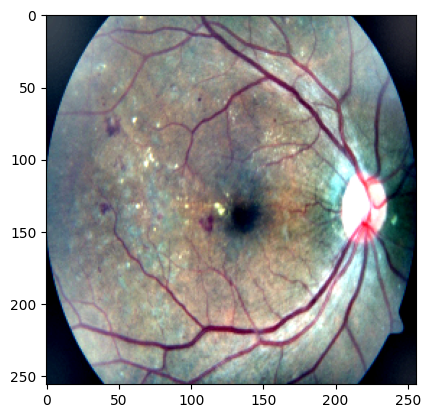

1/1 [==============================] - 0s 110ms/step
[[0.8769907  0.01198846 0.11102089]]
MildModerate


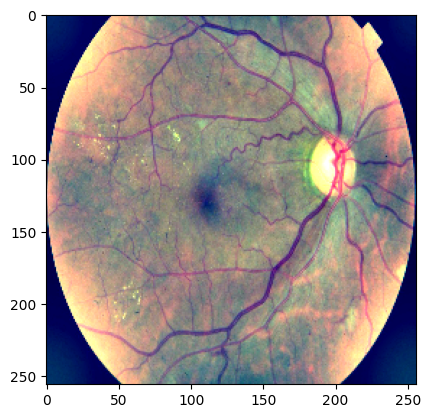

1/1 [==============================] - 0s 95ms/step
[[9.9700147e-01 1.7483307e-04 2.8236790e-03]]
MildModerate


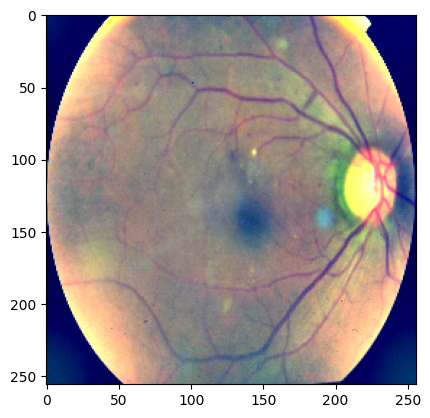

1/1 [==============================] - 0s 107ms/step
[[0.34304178 0.6562323  0.00072598]]
No_DR


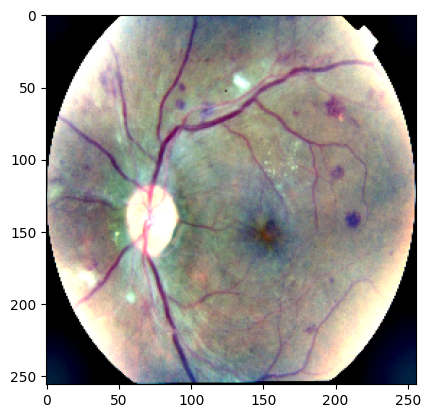

1/1 [==============================] - 0s 101ms/step
[[9.6387941e-01 4.7483612e-04 3.5645731e-02]]
MildModerate


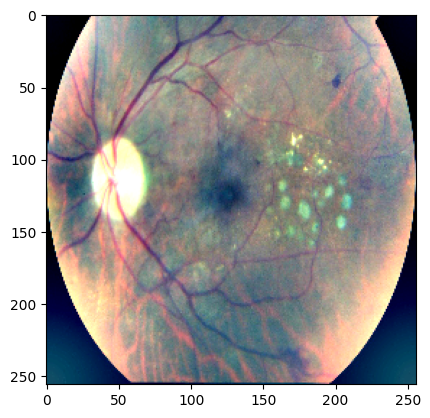

1/1 [==============================] - 0s 136ms/step
[[0.98634166 0.00381047 0.00984793]]
MildModerate


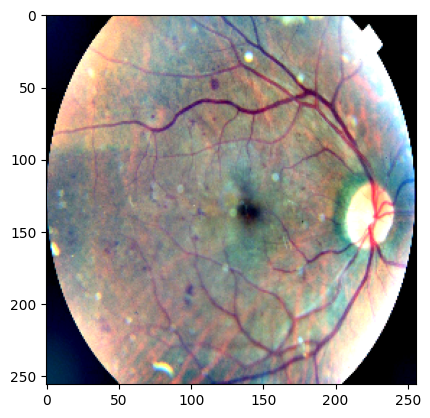

1/1 [==============================] - 0s 185ms/step
[[0.9443731  0.00334052 0.05228648]]
MildModerate


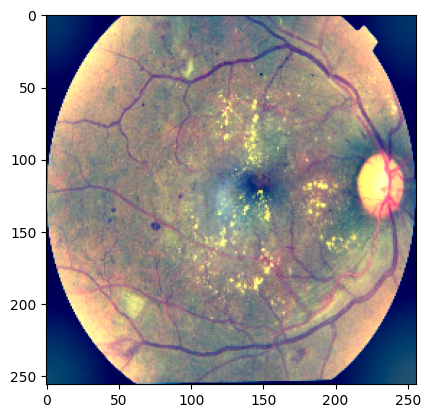

1/1 [==============================] - 0s 178ms/step
[[0.9034779  0.03255922 0.06396285]]
MildModerate


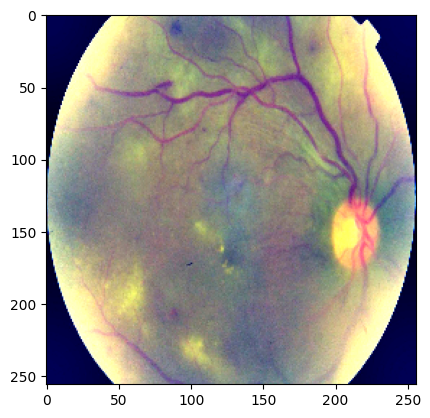

1/1 [==============================] - 0s 196ms/step
[[0.98154646 0.00179186 0.01666165]]
MildModerate


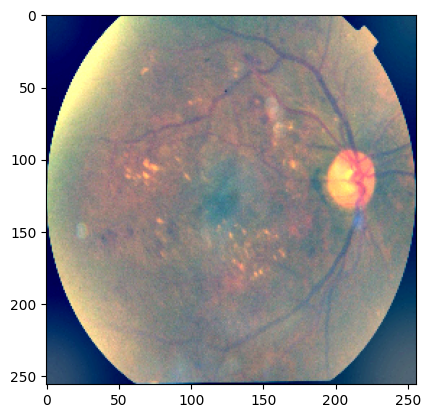

1/1 [==============================] - 0s 151ms/step
[[0.28645185 0.7056276  0.00792049]]
No_DR


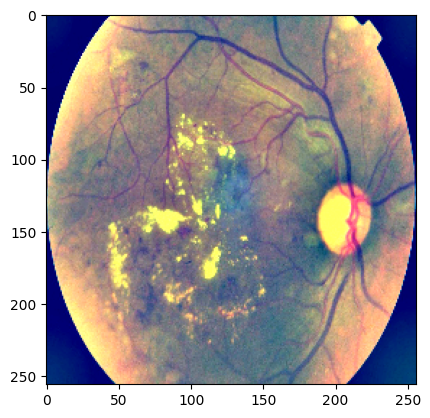

1/1 [==============================] - 0s 183ms/step
[[0.7224406  0.00732617 0.2702332 ]]
MildModerate


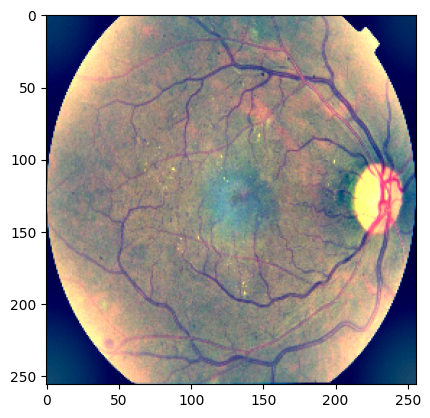

1/1 [==============================] - 0s 125ms/step
[[2.0649289e-01 7.9304552e-01 4.6159682e-04]]
No_DR


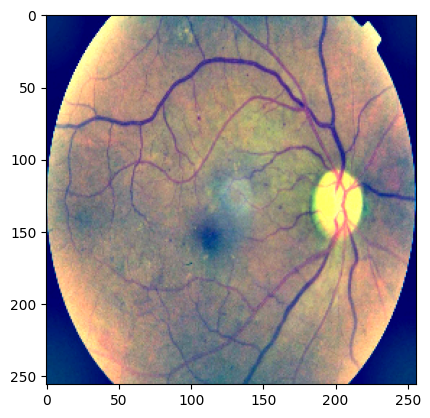

1/1 [==============================] - 0s 149ms/step
[[2.0189662e-01 7.9782498e-01 2.7835433e-04]]
No_DR


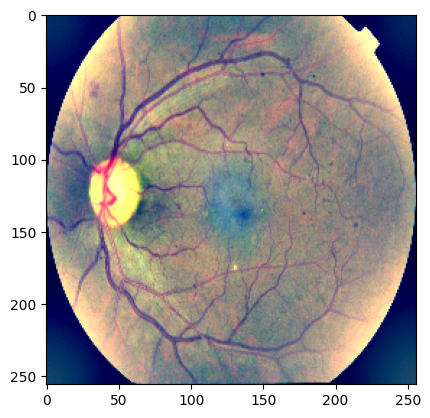

1/1 [==============================] - 0s 159ms/step
[[2.4641016e-02 9.7521079e-01 1.4824014e-04]]
No_DR


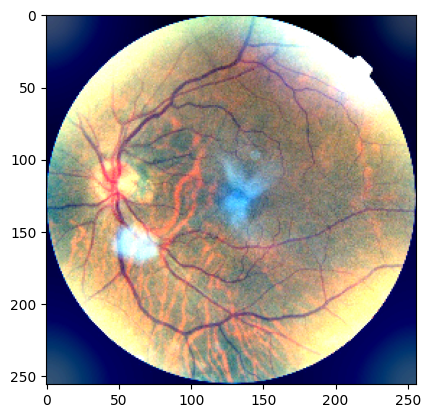

1/1 [==============================] - 0s 117ms/step
[[1.7646333e-04 9.9982303e-01 5.0503996e-07]]
No_DR


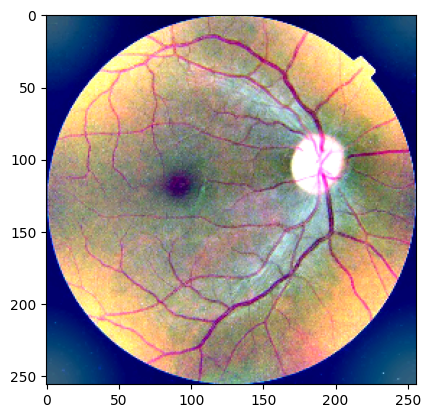

1/1 [==============================] - 0s 111ms/step
[[3.8076036e-05 9.9996173e-01 2.1580134e-07]]
No_DR


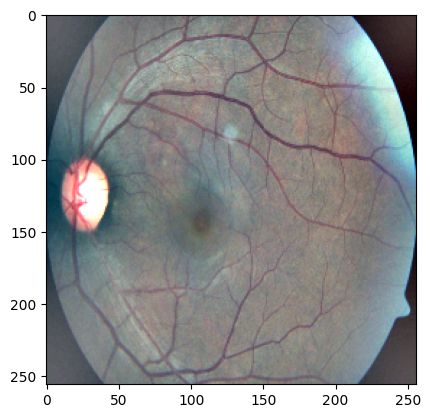

1/1 [==============================] - 0s 160ms/step
[[2.1527877e-02 9.7843540e-01 3.6787675e-05]]
No_DR


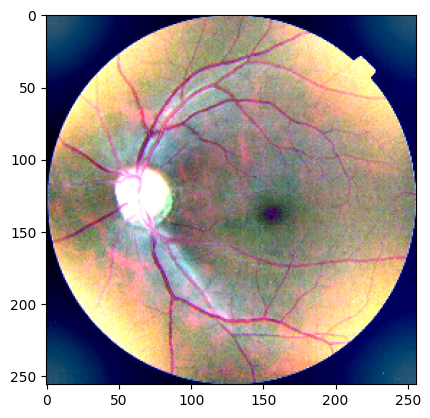

1/1 [==============================] - 0s 135ms/step
[[1.0181905e-06 9.9999893e-01 1.1519089e-09]]
No_DR


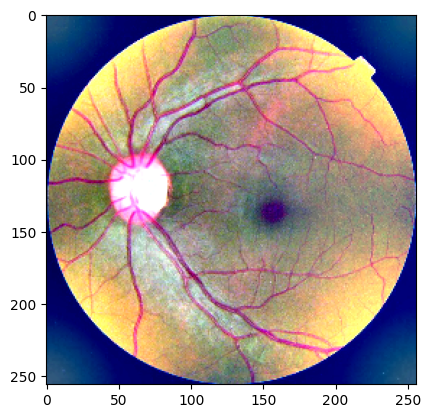

1/1 [==============================] - 0s 159ms/step
[[1.2928307e-04 9.9987054e-01 7.3155462e-08]]
No_DR


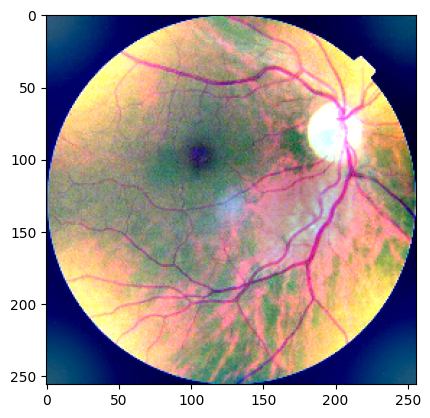

1/1 [==============================] - 0s 156ms/step
[[3.7513144e-07 9.9999964e-01 1.4578760e-09]]
No_DR


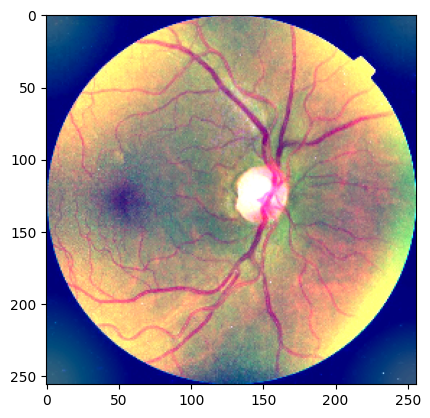

1/1 [==============================] - 0s 137ms/step
[[4.1582348e-04 9.9958140e-01 2.7498882e-06]]
No_DR


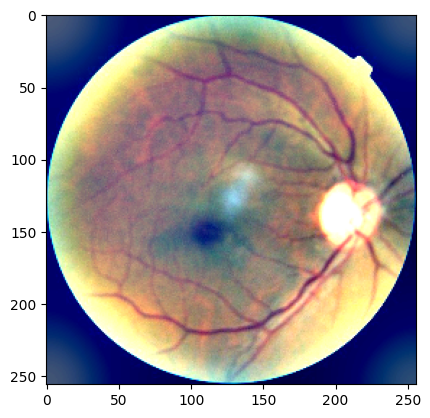

1/1 [==============================] - 0s 136ms/step
[[1.5146360e-03 9.9844509e-01 4.0332594e-05]]
No_DR


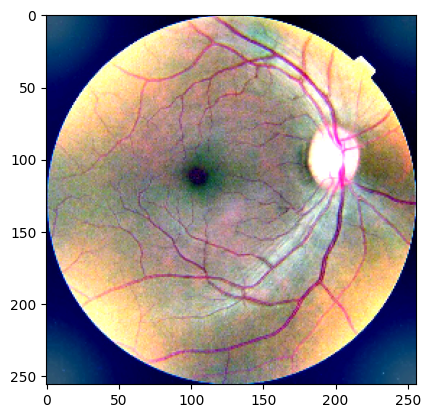

1/1 [==============================] - 0s 148ms/step
[[5.5725486e-06 9.9999440e-01 1.6750967e-08]]
No_DR


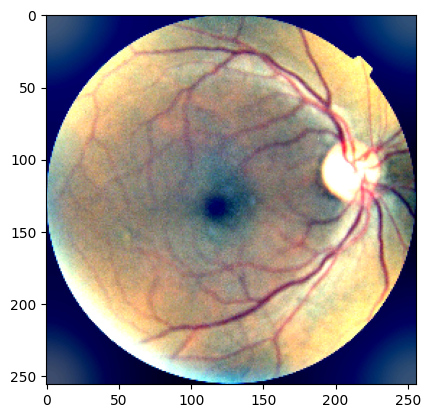

1/1 [==============================] - 0s 163ms/step
[[3.4810542e-03 9.9644852e-01 7.0397327e-05]]
No_DR


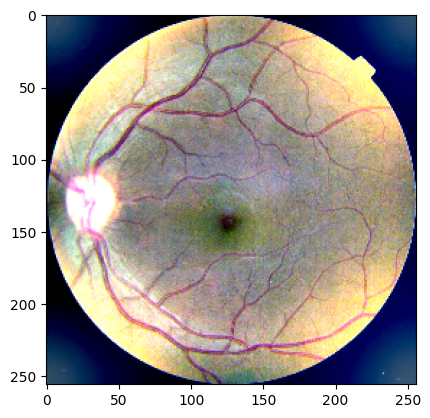

1/1 [==============================] - 0s 177ms/step
[[1.7458915e-04 9.9982470e-01 7.1735195e-07]]
No_DR


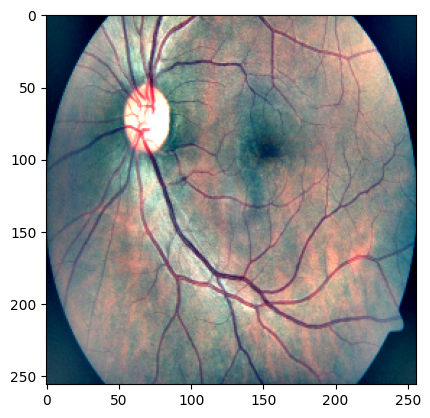

1/1 [==============================] - 0s 185ms/step
[[3.4348739e-04 9.9965549e-01 1.0805542e-06]]
No_DR


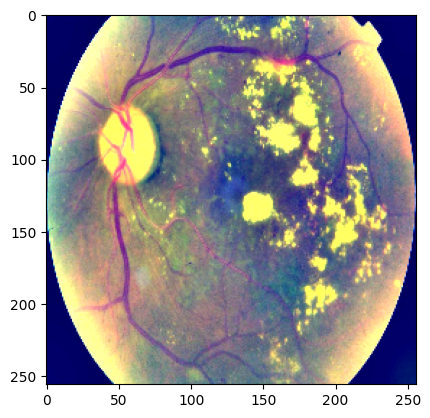

1/1 [==============================] - 0s 175ms/step
[[0.04345204 0.00701739 0.9495306 ]]
SevereProliferate


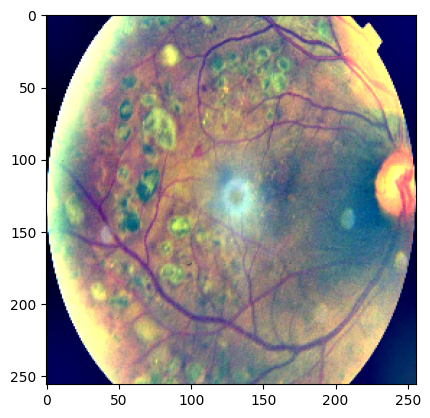

1/1 [==============================] - 0s 189ms/step
[[0.5980964  0.01443368 0.38746995]]
MildModerate


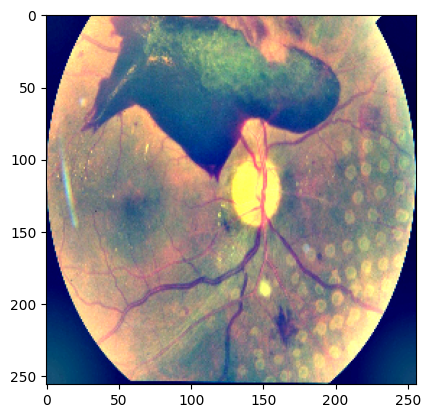

1/1 [==============================] - 0s 190ms/step
[[0.01418623 0.00725207 0.97856176]]
SevereProliferate


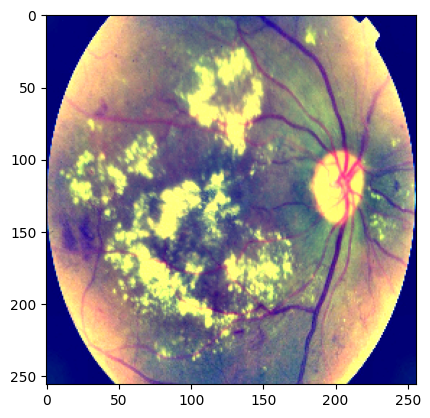

1/1 [==============================] - 0s 172ms/step
[[5.9103308e-04 7.0648166e-05 9.9933833e-01]]
SevereProliferate


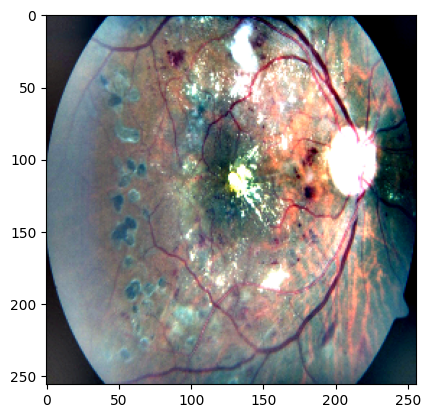

1/1 [==============================] - 0s 150ms/step
[[5.5993307e-02 2.1913015e-04 9.4378752e-01]]
SevereProliferate


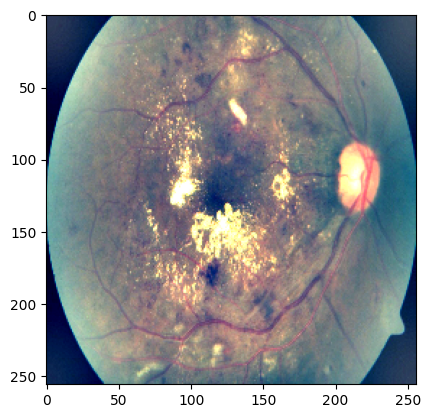

1/1 [==============================] - 0s 178ms/step
[[1.41869355e-02 4.29728796e-04 9.85383391e-01]]
SevereProliferate


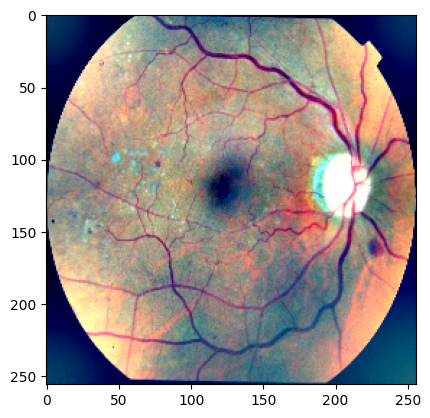

1/1 [==============================] - 0s 147ms/step
[[0.9850545  0.00737716 0.00756837]]
MildModerate


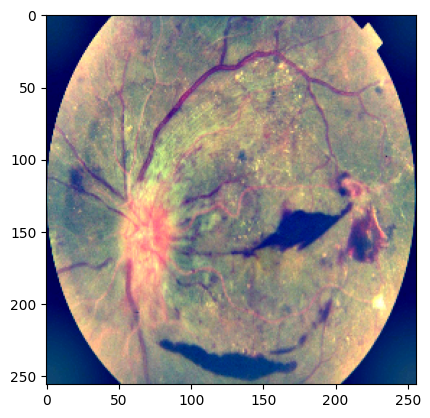

1/1 [==============================] - 0s 166ms/step
[[1.2632154e-03 2.2028293e-04 9.9851650e-01]]
SevereProliferate


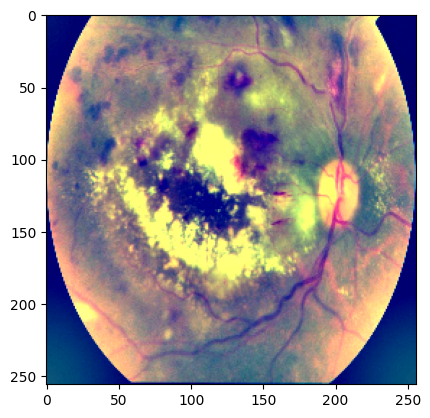

1/1 [==============================] - 0s 163ms/step
[[2.2013290e-04 1.7571576e-04 9.9960417e-01]]
SevereProliferate


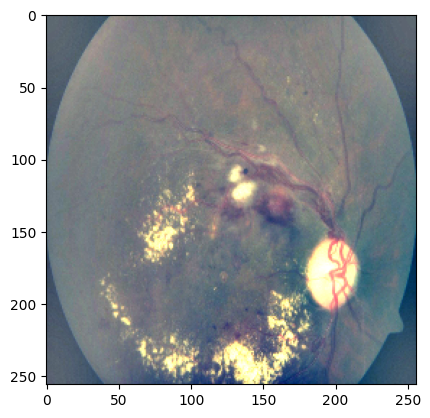

1/1 [==============================] - 0s 178ms/step
[[0.01511687 0.00149773 0.98338544]]
SevereProliferate


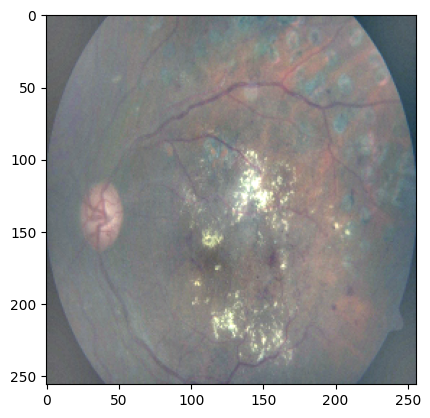

1/1 [==============================] - 0s 181ms/step
[[0.66175795 0.00433219 0.3339098 ]]
MildModerate


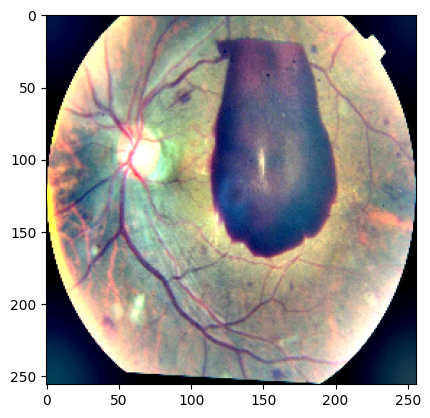

1/1 [==============================] - 0s 157ms/step
[[0.2597702  0.12701155 0.61321825]]
SevereProliferate


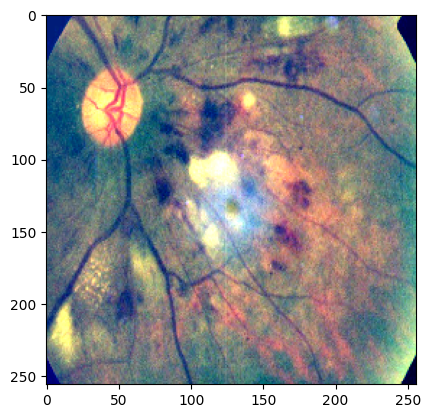

1/1 [==============================] - 0s 142ms/step
[[0.01174961 0.00099549 0.98725486]]
SevereProliferate


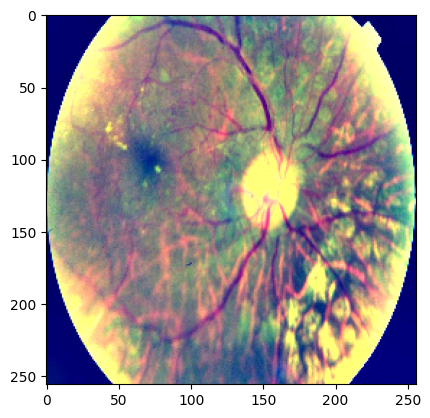

1/1 [==============================] - 0s 148ms/step
[[0.17418621 0.02956133 0.7962524 ]]
SevereProliferate


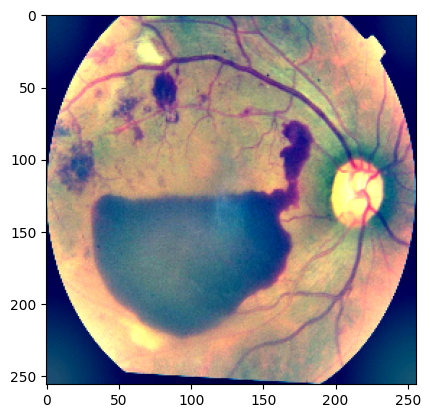

1/1 [==============================] - 0s 212ms/step
[[2.7293465e-04 3.8692118e-03 9.9585789e-01]]
SevereProliferate


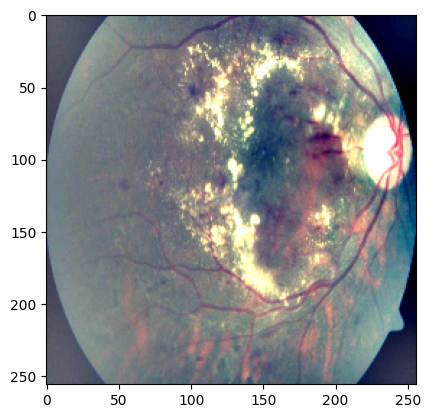

1/1 [==============================] - 0s 190ms/step
[[1.5011658e-03 7.6652927e-05 9.9842215e-01]]
SevereProliferate


In [ ]:
#preprocessing for datagen
def preProcessing1(image):
    sigmaX=30
    #image = cv2.imread(path)
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    #image = crop_image_from_gray(image)
    image = cv2.resize(image, (img_size, img_size))
    image=cv2.addWeighted ( image,4, cv2.GaussianBlur( image , (0,0) , sigmaX) ,-4 ,128)

    return image

#preprocessing for testing code
def preProcessing2(path):
    sigmaX=30
    image = cv2.imread(path)
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    #image = crop_image_from_gray(image)
    image = cv2.resize(image, (img_size, img_size))
    image=cv2.addWeighted ( image,4, cv2.GaussianBlur( image , (0,0) , sigmaX) ,-4 ,128)
    return image

#datagenerator for accuracy evaluation
test_datagen = ImageDataGenerator(rescale=1/255. ,

                                  rotation_range=360,
                                  zoom_range=0.15,
                                  fill_mode='constant',
                                  cval=0.,
                                  horizontal_flip=True,
                                  vertical_flip=True,
                                  preprocessing_function=preProcessing1)

eyedir_path = '/content/drive/MyDrive/FinalDataSet/Test'

test_generator = test_datagen.flow_from_directory(
                                                    eyedir_path,
                                                    target_size=(img_size, img_size),
                                                    batch_size=32,
                                                    class_mode='categorical',
                                                    shuffle=False
                                                  )

classes= ['MildModerate', 'No_DR', 'SevereProliferate']
# Evaluate the model on the test data
test_loss, test_accuracy = model.evaluate(test_generator)


for subdir, dirs, files in os.walk(eyedir_path):
    for file in files:
            image_path = os.path.join(subdir, file)
            img = preProcessing2(image_path)

            plt.imshow(img)
            plt.show()

            img = image.img_to_array(img)
            img = img/255.
            img = img.reshape(1,img_size,img_size, 3)
            prob = model.predict(img)
            print(prob)
            index = np.argmax(prob)
            print(classes[index])

Found 41 images belonging to 3 classes.
2/2 [==============================] - 7s 577ms/step - loss: 0.3263 - accuracy: 0.8780


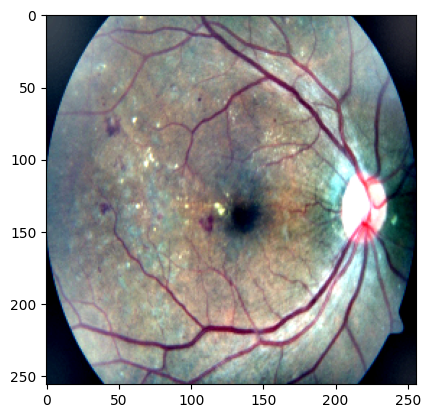

1/1 [==============================] - 2s 2s/step
[[0.8769907  0.01198846 0.11102089]]
MildModerate


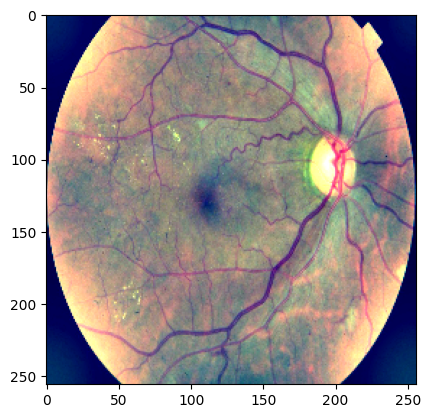

1/1 [==============================] - 0s 106ms/step
[[9.9700147e-01 1.7483307e-04 2.8236790e-03]]
MildModerate


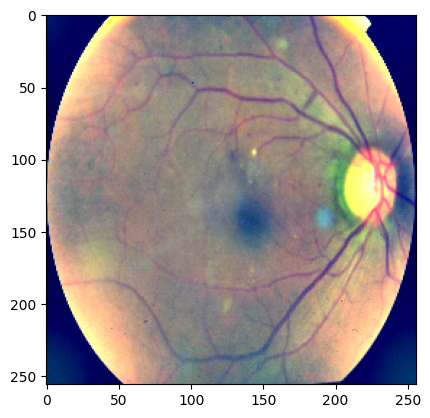

1/1 [==============================] - 0s 95ms/step
[[0.34304178 0.6562323  0.00072598]]
No_DR


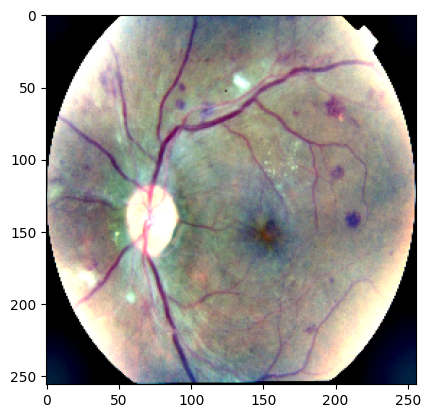

1/1 [==============================] - 0s 94ms/step
[[9.6387941e-01 4.7483612e-04 3.5645731e-02]]
MildModerate


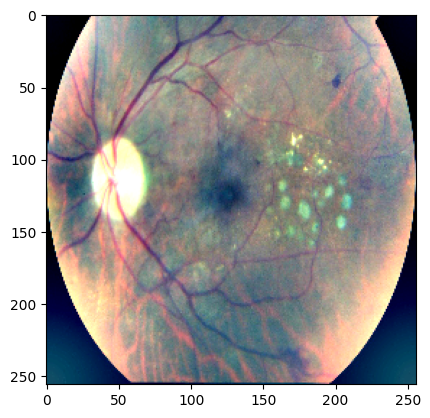

1/1 [==============================] - 0s 95ms/step
[[0.98634166 0.00381047 0.00984793]]
MildModerate


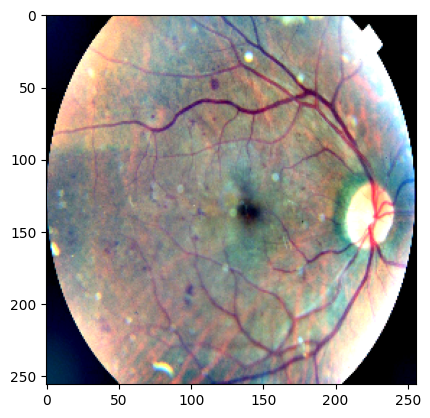

1/1 [==============================] - 0s 159ms/step
[[0.9443731  0.00334052 0.05228648]]
MildModerate


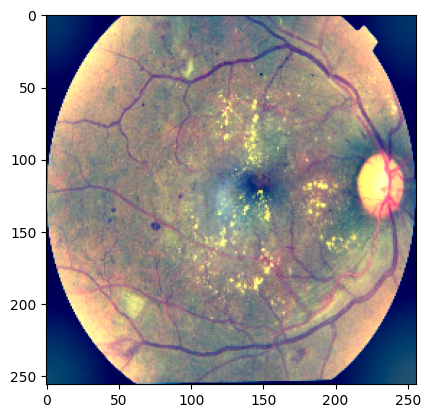

1/1 [==============================] - 0s 193ms/step
[[0.9034779  0.03255922 0.06396285]]
MildModerate


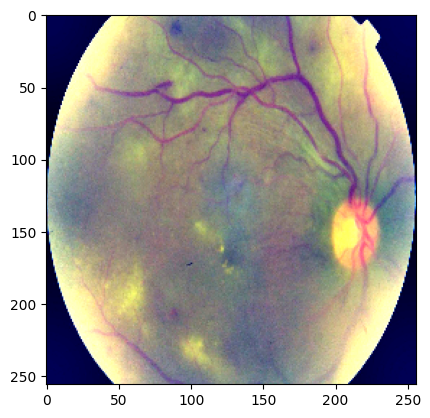

1/1 [==============================] - 0s 166ms/step
[[0.98154646 0.00179186 0.01666165]]
MildModerate


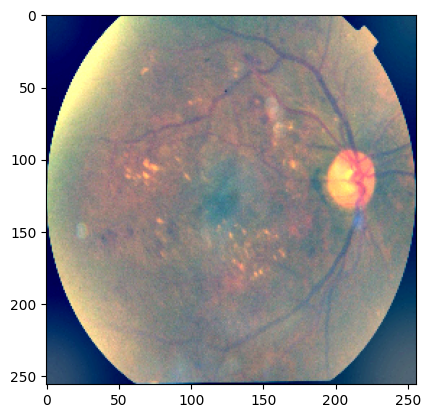

1/1 [==============================] - 0s 169ms/step
[[0.28645185 0.7056276  0.00792049]]
No_DR


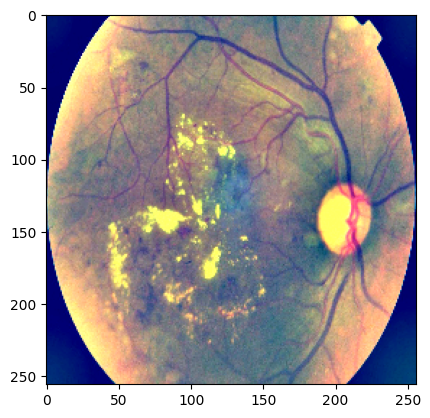

1/1 [==============================] - 0s 180ms/step
[[0.7224406  0.00732617 0.2702332 ]]
MildModerate


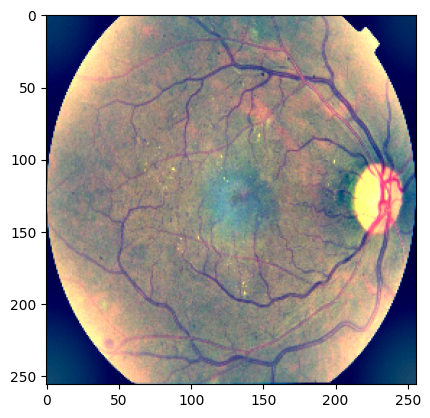

1/1 [==============================] - 0s 182ms/step
[[2.0649289e-01 7.9304552e-01 4.6159682e-04]]
No_DR


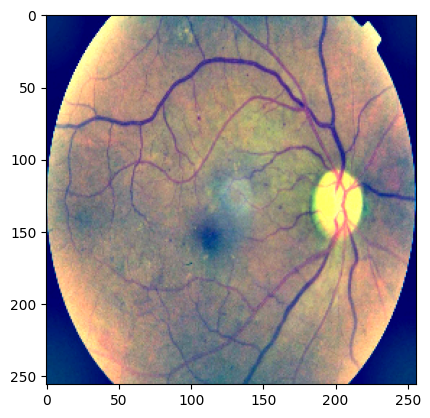

1/1 [==============================] - 0s 163ms/step
[[2.0189662e-01 7.9782498e-01 2.7835433e-04]]
No_DR


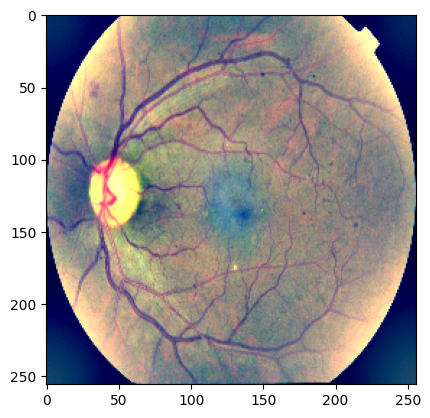

1/1 [==============================] - 0s 121ms/step
[[2.4641016e-02 9.7521079e-01 1.4824014e-04]]
No_DR


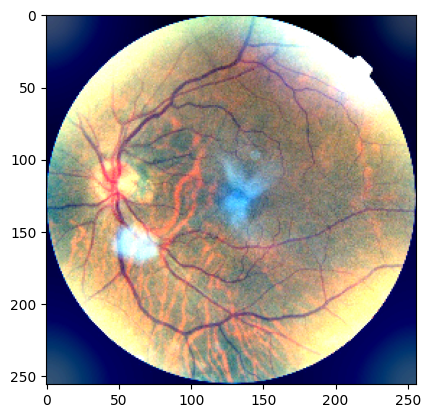

1/1 [==============================] - 0s 124ms/step
[[1.7646333e-04 9.9982303e-01 5.0503996e-07]]
No_DR


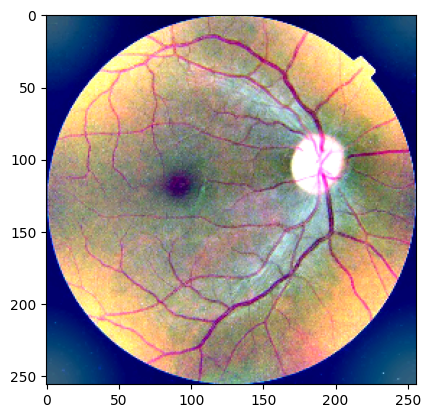

1/1 [==============================] - 0s 114ms/step
[[3.8076036e-05 9.9996173e-01 2.1580134e-07]]
No_DR


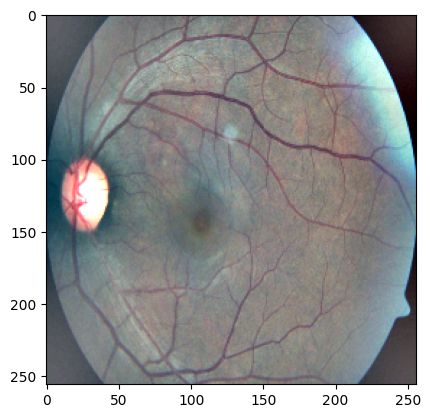

1/1 [==============================] - 0s 155ms/step
[[2.1527877e-02 9.7843540e-01 3.6787675e-05]]
No_DR


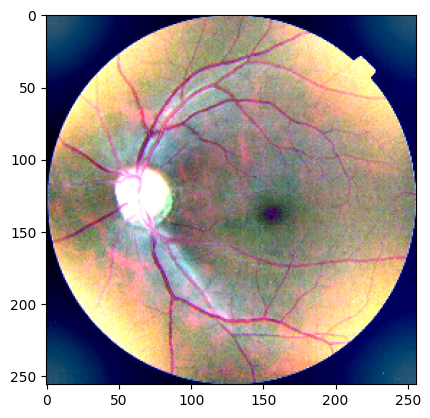

1/1 [==============================] - 0s 140ms/step
[[1.0181905e-06 9.9999893e-01 1.1519089e-09]]
No_DR


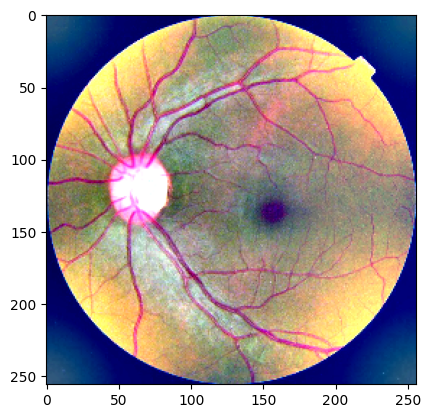

1/1 [==============================] - 0s 148ms/step
[[1.2928307e-04 9.9987054e-01 7.3155462e-08]]
No_DR


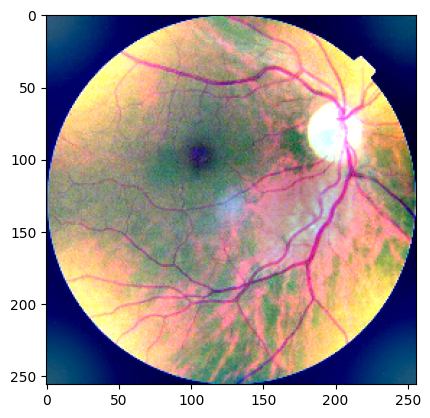

1/1 [==============================] - 0s 152ms/step
[[3.7513144e-07 9.9999964e-01 1.4578760e-09]]
No_DR


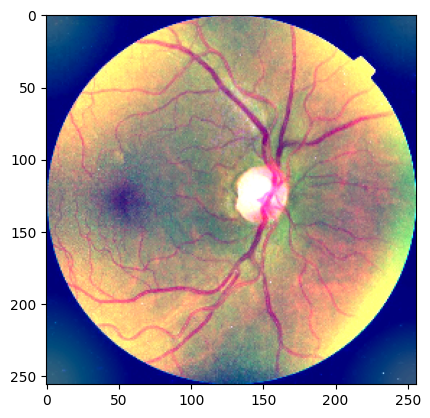

1/1 [==============================] - 0s 215ms/step
[[4.1582348e-04 9.9958140e-01 2.7498882e-06]]
No_DR


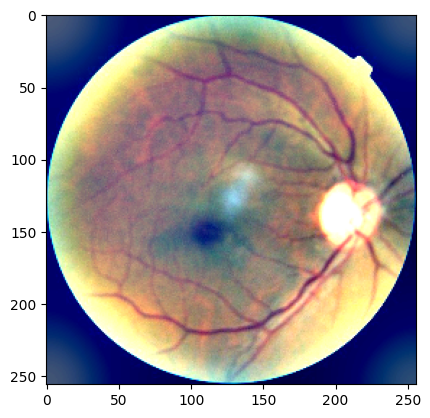

1/1 [==============================] - 0s 314ms/step
[[1.5146360e-03 9.9844509e-01 4.0332594e-05]]
No_DR


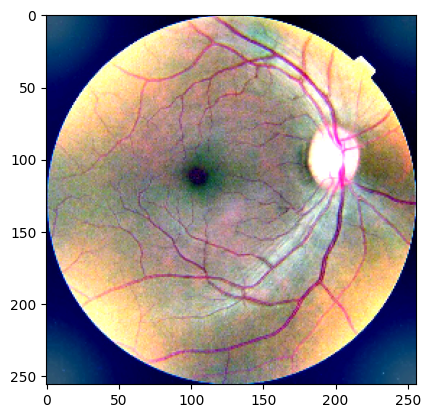

1/1 [==============================] - 0s 191ms/step
[[5.5725486e-06 9.9999440e-01 1.6750967e-08]]
No_DR


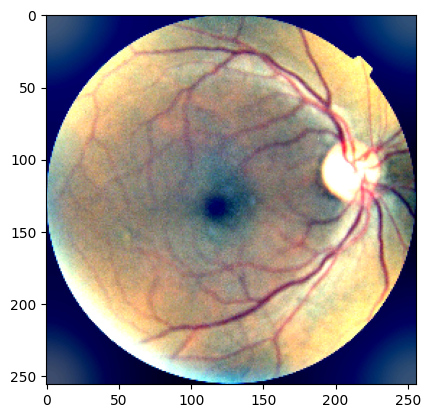

1/1 [==============================] - 0s 253ms/step
[[3.4810542e-03 9.9644852e-01 7.0397327e-05]]
No_DR


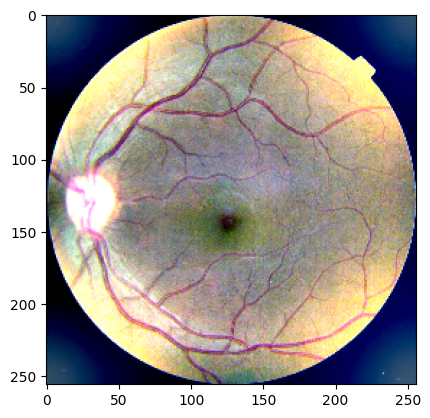

1/1 [==============================] - 0s 247ms/step
[[1.7458915e-04 9.9982470e-01 7.1735195e-07]]
No_DR


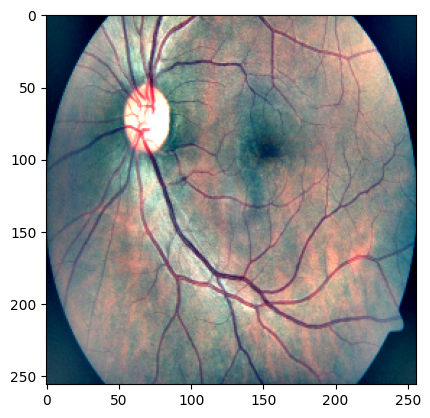

1/1 [==============================] - 0s 278ms/step
[[3.4348739e-04 9.9965549e-01 1.0805542e-06]]
No_DR


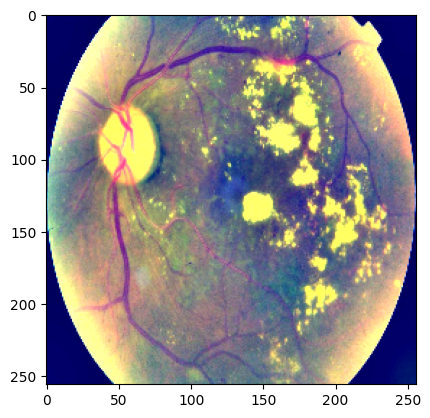

1/1 [==============================] - 0s 164ms/step
[[0.04345204 0.00701739 0.9495306 ]]
SevereProliferate


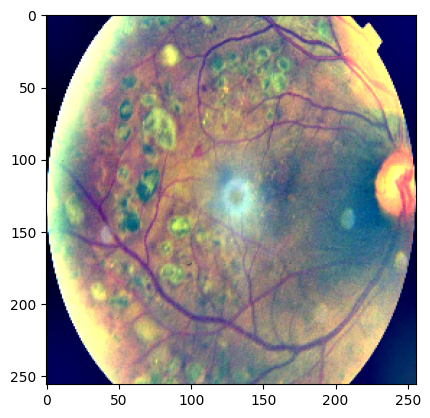

1/1 [==============================] - 0s 264ms/step
[[0.5980964  0.01443368 0.38746995]]
MildModerate


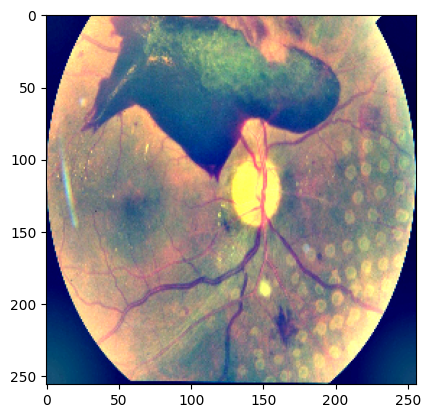

1/1 [==============================] - 0s 239ms/step
[[0.01418623 0.00725207 0.97856176]]
SevereProliferate


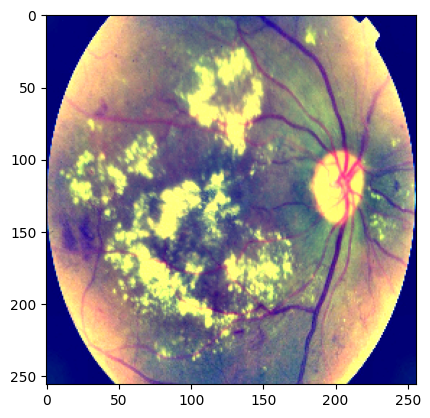

1/1 [==============================] - 0s 208ms/step
[[5.9103308e-04 7.0648166e-05 9.9933833e-01]]
SevereProliferate


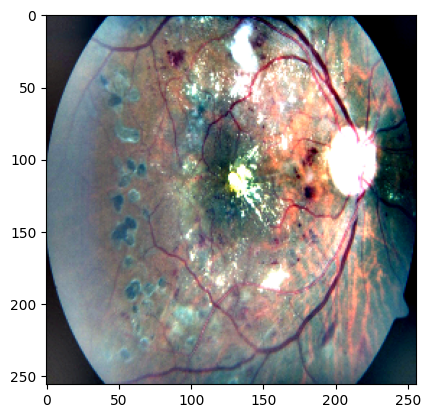

1/1 [==============================] - 0s 181ms/step
[[5.5993307e-02 2.1913015e-04 9.4378752e-01]]
SevereProliferate


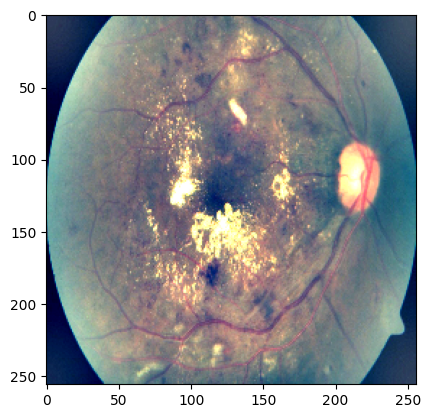

1/1 [==============================] - 0s 132ms/step
[[1.41869355e-02 4.29728796e-04 9.85383391e-01]]
SevereProliferate


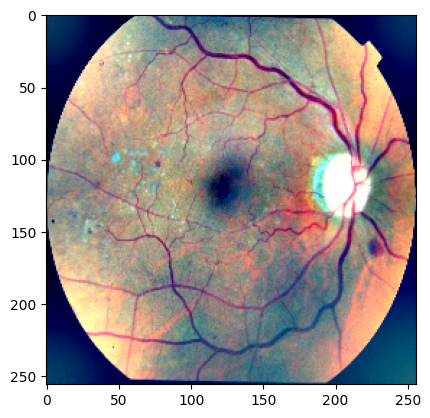

1/1 [==============================] - 0s 151ms/step
[[0.9850545  0.00737716 0.00756837]]
MildModerate


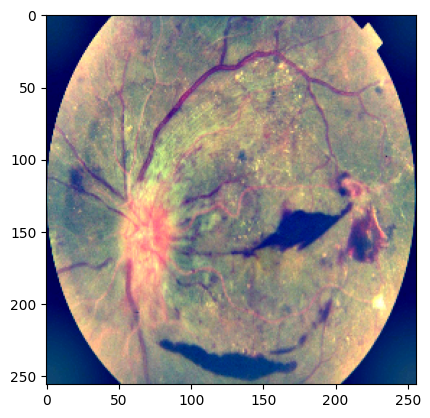

1/1 [==============================] - 0s 195ms/step
[[1.2632154e-03 2.2028293e-04 9.9851650e-01]]
SevereProliferate


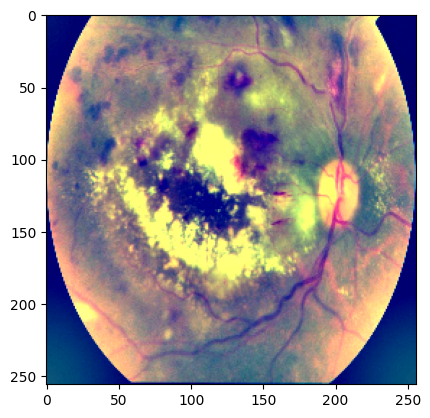

1/1 [==============================] - 0s 165ms/step
[[2.2013290e-04 1.7571576e-04 9.9960417e-01]]
SevereProliferate


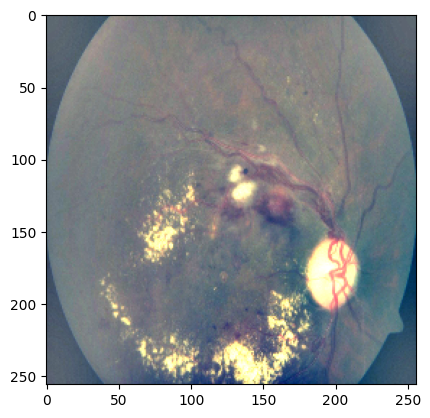

1/1 [==============================] - 0s 189ms/step
[[0.01511687 0.00149773 0.98338544]]
SevereProliferate


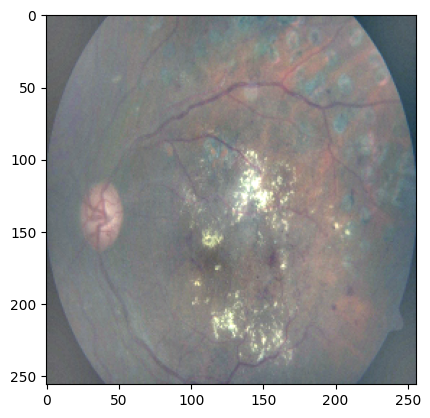

1/1 [==============================] - 0s 169ms/step
[[0.66175795 0.00433219 0.3339098 ]]
MildModerate


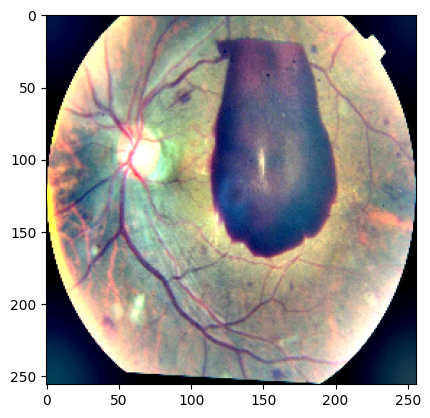

1/1 [==============================] - 0s 200ms/step
[[0.2597702  0.12701155 0.61321825]]
SevereProliferate


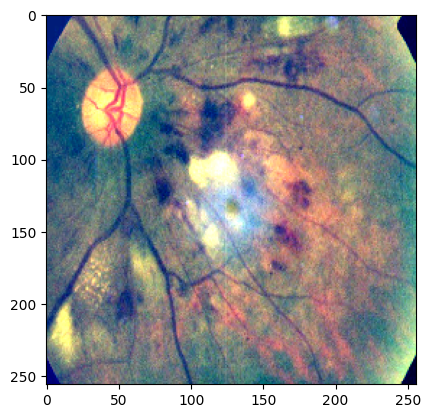

1/1 [==============================] - 0s 198ms/step
[[0.01174961 0.00099549 0.98725486]]
SevereProliferate


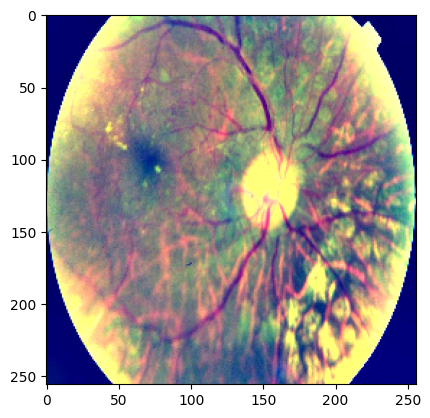

1/1 [==============================] - 0s 213ms/step
[[0.17418621 0.02956133 0.7962524 ]]
SevereProliferate


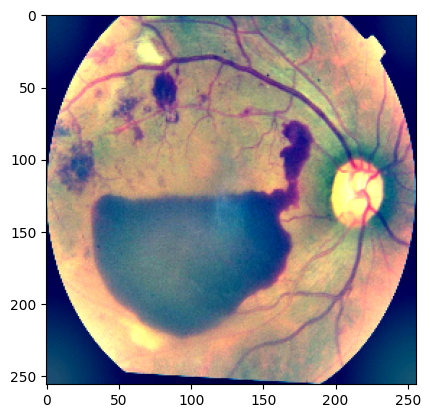

1/1 [==============================] - 0s 213ms/step
[[2.7293465e-04 3.8692118e-03 9.9585789e-01]]
SevereProliferate


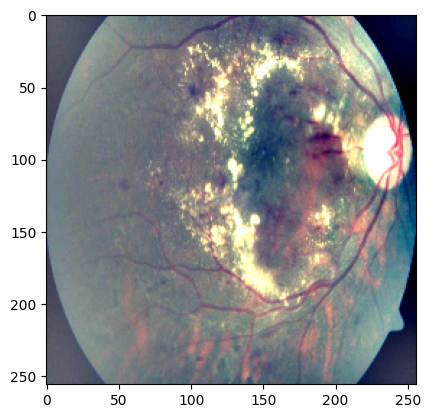

1/1 [==============================] - 0s 160ms/step
[[1.5011658e-03 7.6652927e-05 9.9842215e-01]]
SevereProliferate


In [ ]:
#preprocessing for datagen
def preProcessing1(image):
    sigmaX=30
    #image = cv2.imread(path)
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    #image = crop_image_from_gray(image)
    image = cv2.resize(image, (img_size, img_size))
    image=cv2.addWeighted ( image,4, cv2.GaussianBlur( image , (0,0) , sigmaX) ,-4 ,128)

    return image

#preprocessing for testing code
def preProcessing2(path):
    sigmaX=30
    image = cv2.imread(path)
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    #image = crop_image_from_gray(image)
    image = cv2.resize(image, (img_size, img_size))
    image=cv2.addWeighted ( image,4, cv2.GaussianBlur( image , (0,0) , sigmaX) ,-4 ,128)
    return image

#datagenerator for accuracy evaluation
test_datagen = ImageDataGenerator(rescale=1/255. ,

                                  rotation_range=360,
                                  zoom_range=0.15,
                                  fill_mode='constant',
                                  cval=0.,
                                  horizontal_flip=True,
                                  vertical_flip=True,
                                  preprocessing_function=preProcessing1)

eyedir_path = '/content/drive/MyDrive/FinalDataSet/Test'

test_generator = test_datagen.flow_from_directory(
                                                    eyedir_path,
                                                    target_size=(img_size, img_size),
                                                    batch_size=32,
                                                    class_mode='categorical',
                                                    shuffle=False
                                                  )

classes= ['MildModerate', 'No_DR', 'SevereProliferate']
# Evaluate the model on the test data
test_loss, test_accuracy = model.evaluate(test_generator)


for subdir, dirs, files in os.walk(eyedir_path):
    for file in files:
            image_path = os.path.join(subdir, file)
            img = preProcessing2(image_path)

            plt.imshow(img)
            plt.show()

            img = image.img_to_array(img)
            img = img/255.
            img = img.reshape(1,img_size,img_size, 3)
            prob = model.predict(img)
            print(prob)
            index = np.argmax(prob)
            print(classes[index])

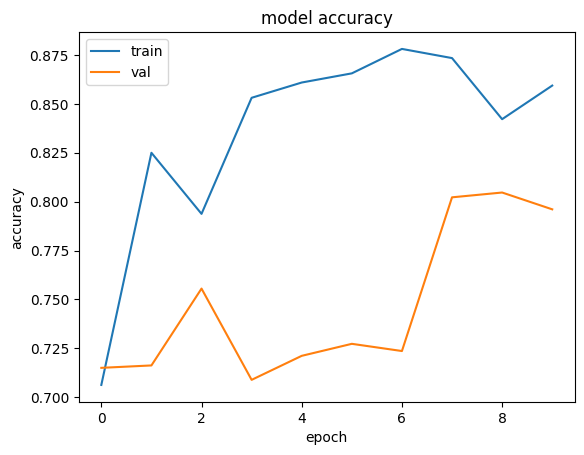

In [ ]:
plt.plot(model_fit.history['accuracy'])
plt.plot(model_fit.history['val_accuracy'])
plt.title('model accuracy')
plt.ylabel('accuracy')
plt.xlabel('epoch')
plt.legend(['train', 'val'], loc='upper left')
plt.show()

2/2 [==============================] - 7s 549ms/step


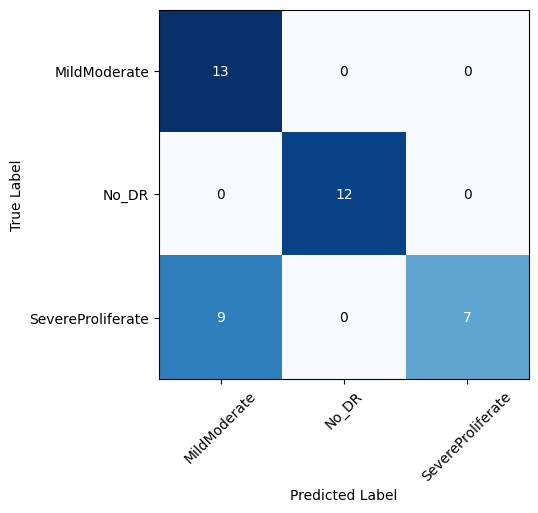

In [ ]:
predictions = model.predict(test_generator)

predicted_classes = np.argmax(predictions, axis=1)
true_classes = test_generator.classes
class_labels = list(test_generator.class_indices.keys())

cm = confusion_matrix(true_classes, predicted_classes)

plt.imshow(cm, cmap='Blues')
tick_marks = np.arange(len(test_generator.class_indices))
plt.xticks(tick_marks, test_generator.class_indices, rotation=45)
plt.yticks(tick_marks, test_generator.class_indices)
plt.xlabel('Predicted Label')
plt.ylabel('True Label')

thresh = cm.max() / 2.
for i in range(cm.shape[0]):
    for j in range(cm.shape[1]):
        plt.text(j, i, format(cm[i, j], 'd'),
                 ha="center", va="center",
                 color="white" if cm[i, j] > thresh else "black")

plt.show()

In [ ]:
model_fit=model.fit(train_dataset,validation_data = validation_dataset,epochs=10,steps_per_epoch=10)

Epoch 1/10
10/10 [==============================] - 305s 28s/step - loss: 0.7422 - accuracy: 0.6562 - val_loss: 1.2058 - val_accuracy: 0.5602
Epoch 2/10
10/10 [==============================] - 96s 10s/step - loss: 0.5827 - accuracy: 0.7875 - val_loss: 0.8507 - val_accuracy: 0.6929
Epoch 3/10
10/10 [==============================] - 92s 10s/step - loss: 0.4783 - accuracy: 0.7937 - val_loss: 0.9792 - val_accuracy: 0.6339
Epoch 4/10
10/10 [==============================] - 83s 9s/step - loss: 0.4897 - accuracy: 0.7937 - val_loss: 0.8645 - val_accuracy: 0.6634
Epoch 5/10
10/10 [==============================] - 77s 8s/step - loss: 0.3711 - accuracy: 0.8562 - val_loss: 1.9357 - val_accuracy: 0.5430
Epoch 6/10
10/10 [==============================] - 78s 8s/step - loss: 0.4286 - accuracy: 0.8250 - val_loss: 1.5434 - val_accuracy: 0.6204
Epoch 7/10
10/10 [==============================] - 70s 7s/step - loss: 0.4578 - accuracy: 0.8094 - val_loss: 0.9570 - val_accuracy: 0.7334
Epoch 8/10
10/10

In [ ]:
model_fit=model.fit(train_dataset,validation_data = validation_dataset,epochs=10,steps_per_epoch=10)

Epoch 1/10
10/10 [==============================] - 254s 18s/step - loss: 0.6923 - accuracy: 0.6781 - val_loss: 2.0812 - val_accuracy: 0.4877
Epoch 2/10
10/10 [==============================] - 80s 8s/step - loss: 0.5318 - accuracy: 0.7688 - val_loss: 2.9751 - val_accuracy: 0.4926
Epoch 3/10
10/10 [==============================] - 76s 8s/step - loss: 0.4009 - accuracy: 0.8219 - val_loss: 1.8726 - val_accuracy: 0.5897
Epoch 4/10
10/10 [==============================] - 69s 7s/step - loss: 0.4567 - accuracy: 0.8062 - val_loss: 1.5028 - val_accuracy: 0.6364
Epoch 5/10
10/10 [==============================] - 69s 7s/step - loss: 0.4785 - accuracy: 0.8375 - val_loss: 1.1991 - val_accuracy: 0.6548
Epoch 6/10
10/10 [==============================] - 66s 7s/step - loss: 0.3846 - accuracy: 0.8500 - val_loss: 1.1904 - val_accuracy: 0.6757
Epoch 7/10
10/10 [==============================] - 63s 7s/step - loss: 0.3672 - accuracy: 0.8594 - val_loss: 2.5696 - val_accuracy: 0.6646
Epoch 8/10
10/10 [